In [3]:
%pip install --upgrade pip

  Obtaining dependency information for pip from https://files.pythonhosted.org/packages/ef/7d/500c9ad20238fcfcb4cb9243eede163594d7020ce87bd9610c9e02771876/pip-24.3.1-py3-none-any.whl.metadata
Using cached pip-24.3.1-py3-none-any.whl (1.8 MB)
  Attempting uninstall: pip
    Found existing installation: pip 23.2.1
    Uninstalling pip-23.2.1:
      Successfully uninstalled pip-23.2.1
Note: you may need to restart the kernel to use updated packages.


In [5]:
%pip install pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 6.5 MB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [1]:
import os
import json
from glob import glob
from pathlib import Path
from PIL import Image, ImageDraw, ImageOps

In [2]:
def read_json(filename: str):
    with Path(filename).open(encoding='utf8') as handle:
        ann = json.load(handle)
    return ann


nation_dict = {
    'vi': 'vietnamese_receipt',
    'th': 'thai_receipt',
    'zh': 'chinese_receipt',
    'ja': 'japanese_receipt',
}

In [3]:
def save_vis_to_img(save_dir: str | os.PathLike, inference_dir: str | os.PathLike = 'output.json') -> None:
    if not os.path.exists(save_dir):
        os.makedirs(save_dir, exist_ok=True)    
    data = read_json(inference_dir)
    for im, points in data['images'].items():
        # change to 'train' for train dataset 
        im_path = Path('data') / nation_dict[im.split('.')[1]] / 'img' / 'train' / im
        img = Image.open(im_path).convert("RGB")
        img = ImageOps.exif_transpose(img)
        draw = ImageDraw.Draw(img)
        for obj_k, obj_v in points['words'].items():
            # bbox points
            pts = [(int(p[0]), int(p[1])) for p in obj_v['points']]
            pt1 = sorted(pts, key=lambda x: (x[1], x[0]))[0]

            draw.polygon(pts, outline=(255, 0, 0))                
            draw.text(
                (pt1[0]-3, pt1[1]-12),
                obj_k,
                fill=(0, 0, 0)
            )
        img.save(os.path.join(save_dir, im))
    

In [12]:
ls

__pycache__/        detect.py        loss.py           train.py
bounding_box.ipynb  deteval.py       model.py          visualization.py
data/               east_dataset.py  pths/
dataset.py          inference.py     requirements.txt


In [13]:
#save_vis_to_img(r'./data/chinese_receipt/img/train/visualized', r'./data/chinese_receipt/ufo/train.json')
save_vis_to_img(r'./japanese_receipt/img/train/visualized', r'./data/japanese_receipt/ufo/train.json')
save_vis_to_img(r'./thai_receipt/img/train/visualized', r'./data/thai_receipt/ufo/train.json')
save_vis_to_img(r'./vietnamese_receipt/img/train/visualized', r'./data/vietnamese_receipt/ufo/train.json')


# empty 파일 시각화

In [4]:
# empty 파일 저장
#save_vis_to_img(r'./chinese_receipt/img/train/empty_visualized', r'./data/chinese_receipt/ufo/chinese_empty_annotation_train.json')
save_vis_to_img(r'./japanese_receipt/img/train/empty_visualized', r'./data/japanese_receipt/ufo/japanese_empty_annotation_train.json')
save_vis_to_img(r'./thai_receipt/img/train/empty_visualized', r'./data/thai_receipt/ufo/thai_empty_annotation_train.json')
save_vis_to_img(r'./vietnamese_receipt/img/train/empty_visualized', r'./data/vietnamese_receipt/ufo/vietnamese_empty_annotation_train.json')

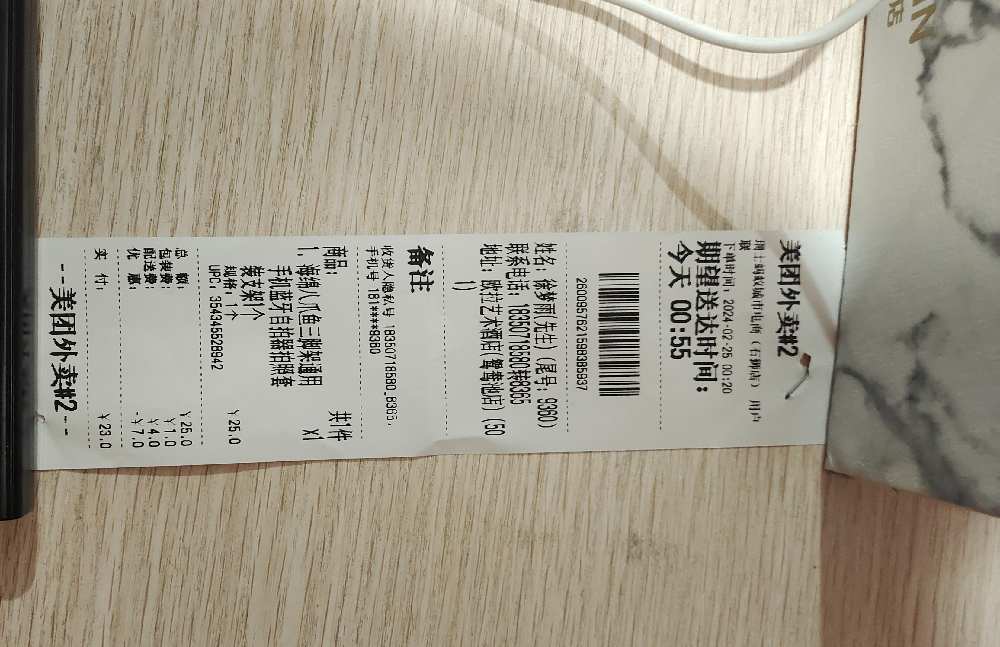

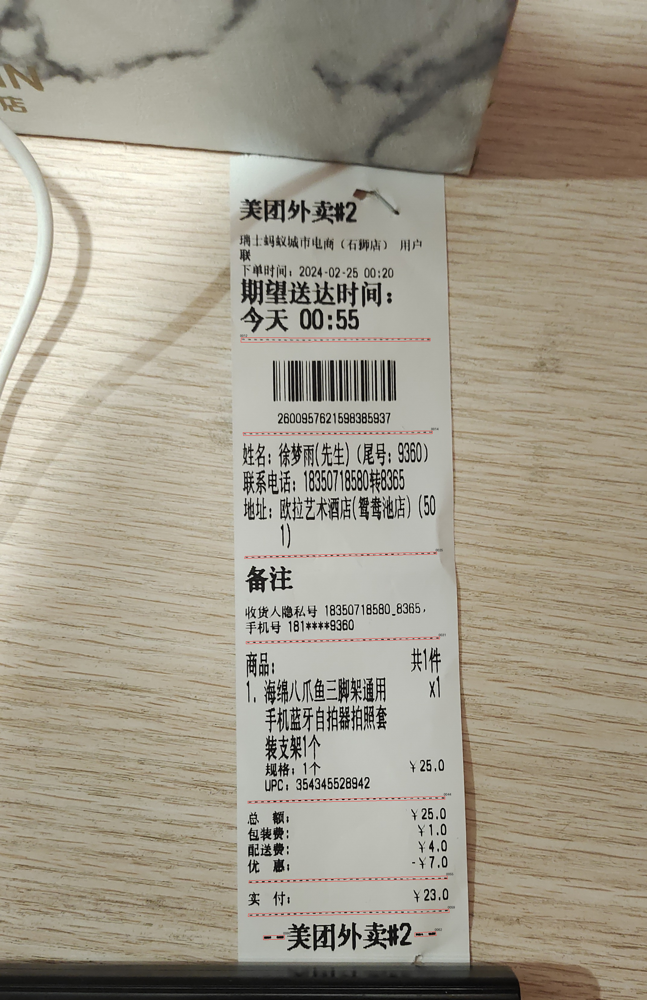

In [8]:
save_vis_to_img(r'./chinese_receipt/img/train/empty_visualized', r'./data/chinese_receipt/ufo/chinese_empty_annotation_train.json')

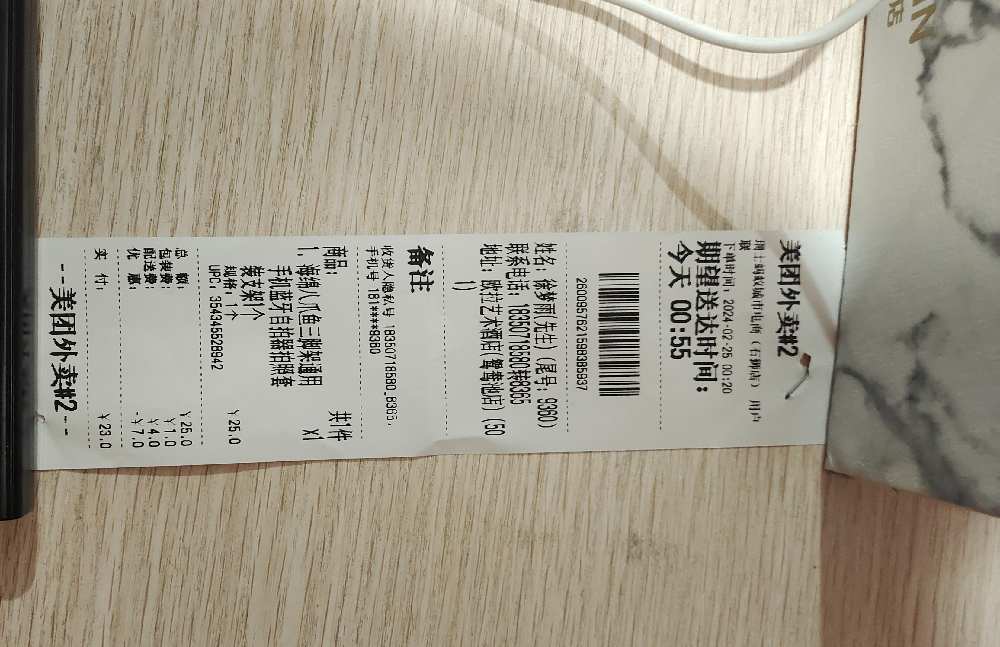

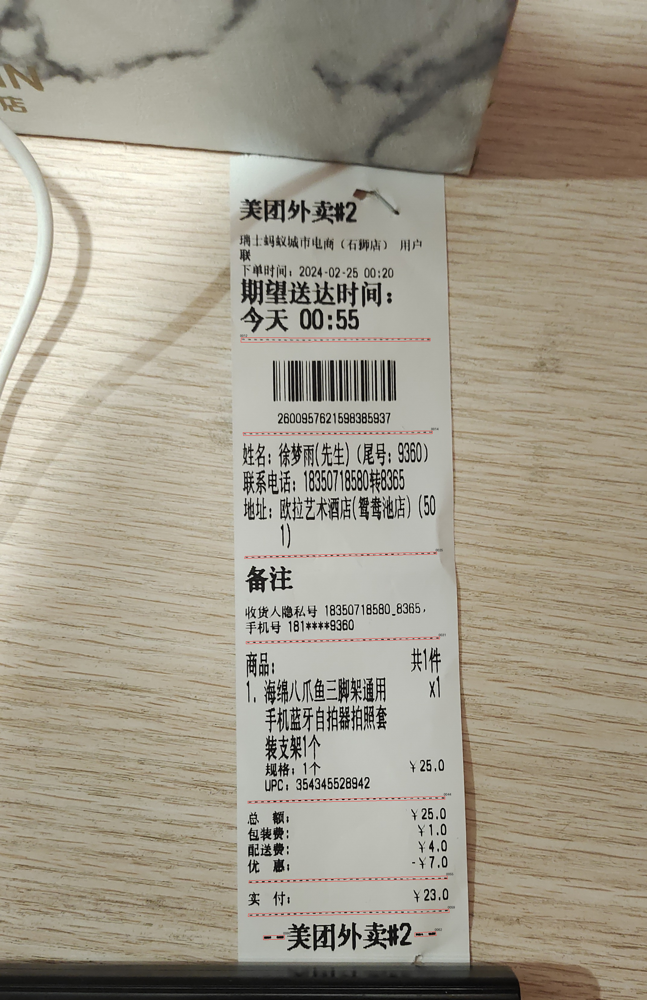

In [14]:
import os
import json
from glob import glob
from pathlib import Path
from PIL import Image, ImageDraw, ImageOps


def read_json(filename: str):
    with Path(filename).open(encoding='utf8') as handle:
        ann = json.load(handle)
    return ann


nation_dict = {
    'vi': 'vietnamese_receipt',
    'th': 'thai_receipt',
    'zh': 'chinese_receipt',
    'ja': 'japanese_receipt',
}

def save_vis_to_img(save_dir: str | os.PathLike, inference_dir: str | os.PathLike = 'output.json') -> None:
    if not os.path.exists(save_dir):
        os.makedirs(save_dir, exist_ok=True)    
    data = read_json(inference_dir)
    for im, points in data['images'].items():
        # change to 'train' for train dataset 
        if im == 'extractor.zh.in_house.appen_001018_page0001.jpg':
            im_path = Path('data') / nation_dict[im.split('.')[1]] / 'img' / 'train' / im
            img = Image.open(im_path).convert("RGB")
            img.show()
            # 이미지 방향 조정
            img = img.transpose(Image.ROTATE_90)  # 90도 회전
            draw = ImageDraw.Draw(img)
            for obj_k, obj_v in points['words'].items():
                # bbox points
                pts = [(int(p[0]), int(p[1])) for p in obj_v['points']]
                pt1 = sorted(pts, key=lambda x: (x[1], x[0]))[0]

                draw.polygon(pts, outline=(255, 0, 0))                
                draw.text(
                    (pt1[0]-3, pt1[1]-12),
                    obj_k,
                    fill=(0, 0, 0)
                )
            img.show()
            img.save(os.path.join(save_dir, im.replace(".jpg", "_test.jpg")))
            break


#save_vis_to_img(r'./japanese_receipt/img/train/visualized', r'./data/japanese_receipt/ufo/train.json')
#save_vis_to_img(r'./thai_receipt/img/train/visualized', r'./data/thai_receipt/ufo/train.json')
#save_vis_to_img(r'./vietnamese_receipt/img/train/visualized', r'./data/vietnamese_receipt/ufo/train.json')
#save_vis_to_img(r'./data/chinese_receipt/img/train/visualized', r'./data/chinese_receipt/ufo/train.json')

#save_vis_to_img(r'./data/chinese_receipt/img/train/visualized', r'./data/chinese_receipt/ufo/train.json')

# empty 시각화
save_vis_to_img(r'./chinese_receipt/img/train/empty_visualized', r'./data/chinese_receipt/ufo/chinese_empty_annotation_train.json')

In [16]:
def save_vis_to_img(save_dir: str | os.PathLike, inference_dir: str | os.PathLike = 'output.json') -> None:
    if not os.path.exists(save_dir):
        os.makedirs(save_dir, exist_ok=True)    
    data = read_json(inference_dir)
    for im, points in data['images'].items():
        # change to 'train' for train dataset 
        im_path = Path('data') / nation_dict[im.split('.')[1]] / 'img' / 'train' / im
        img = Image.open(im_path).convert("RGB")
        # 이미지 방향 조정
        if im == 'extractor.zh.in_house.appen_000689_page0001.jpg':  # 조건문 추가
            img = img.transpose(Image.ROTATE_270)  # 90도 회전
        draw = ImageDraw.Draw(img)
        for obj_k, obj_v in points['words'].items():
            # bbox points
            pts = [(int(p[0]), int(p[1])) for p in obj_v['points']]
            pt1 = sorted(pts, key=lambda x: (x[1], x[0]))[0]

            draw.polygon(pts, outline=(255, 0, 0))                
            draw.text(
                (pt1[0]-3, pt1[1]-12),
                obj_k,
                fill=(0, 0, 0)
            )
        img.save(os.path.join(save_dir, im))
    
# empty 시각화
save_vis_to_img(r'./chinese_receipt/img/train/empty_visualized', r'./data/chinese_receipt/ufo/chinese_empty_annotation_train.json')

In [22]:
def save_vis_to_img(save_dir: str | os.PathLike, inference_dir: str | os.PathLike = 'output.json') -> None:
    if not os.path.exists(save_dir):
        os.makedirs(save_dir, exist_ok=True)    
    data = read_json(inference_dir)
    for im, points in data['images'].items():
        # change to 'train' for train dataset 
        im_path = Path('data') / nation_dict[im.split('.')[1]] / 'img' / 'train' / im
        img = Image.open(im_path).convert("RGB")

        # 이미지 방향 조정
        if im == 'extractor.zh.in_house.appen_000689_page0001.jpg':  # 조건문 추가
            img = img.transpose(Image.ROTATE_270)  # 270도 회전
        elif im == 'extractor.zh.in_house.appen_001018_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_90) 
        elif im == 'extractor.zh.in_house.appen_000346_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_270) 
        elif im == 'extractor.zh.in_house.appen_000363_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_270)
        elif im == 'extractor.zh.in_house.appen_000386_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_270)
        elif im == 'extractor.zh.in_house.appen_000388_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_270)
        elif im == 'extractor.zh.in_house.appen_000700_page0001.jpg':  # 조건문 추가
            # EXIF 회전 오류 방지 - 직접 90도 회전
            img = img.transpose(Image.ROTATE_270) 

        draw = ImageDraw.Draw(img)
        for obj_k, obj_v in points['words'].items():
            # bbox points
            pts = [(int(p[0]), int(p[1])) for p in obj_v['points']]
            pt1 = sorted(pts, key=lambda x: (x[1], x[0]))[0]

            draw.polygon(pts, outline=(255, 0, 0))                
            draw.text(
                (pt1[0]-3, pt1[1]-12),
                obj_k,
                fill=(0, 0, 0)
            )
        img.save(os.path.join(save_dir, im))
    
# empty 시각화
save_vis_to_img(r'./chinese_receipt/img/train/empty_visualized', r'./data/chinese_receipt/ufo/chinese_empty_annotation_train.json')